# [Listing price drivers for Seattle Airbnb using CRISP-DM](https://chrisestevez.github.io/)

* Loaded libraries and data used in the project

In [1]:
#python 3.8.3
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from sklearn.metrics import r2_score
import numpy as np
import pandas as pd
import datetime as dt
import seaborn as sns


sns.set(rc={'figure.figsize':(15,10)})
sns.set(font_scale=1)
sns.set_style("whitegrid")
calendar = pd.read_csv('./Data/calendar.csv',dtype={'listing_id': str})
listings = pd.read_csv('./Data/listings.csv',dtype={'id': str})



# Calendar DF

* Analyzed the structure of the data.

In [2]:
calendar.head()

,listing_id,date,available,price
0,241032,2016-01-04,t,$85.00
1,241032,2016-01-05,t,$85.00
2,241032,2016-01-06,f,NaN
3,241032,2016-01-07,f,NaN
4,241032,2016-01-08,f,NaN


In [15]:
calendar.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1393570 entries, 0 to 1393569
Data columns (total 4 columns):
 #   Column      Non-Null Count    Dtype 
---  ------      --------------    ----- 
 0   listing_id  1393570 non-null  object
 1   date        1393570 non-null  object
 2   available   1393570 non-null  object
 3   price       934542 non-null   object
dtypes: object(4)
memory usage: 42.5+ MB


* Plot of missing data in the calendar data frame.

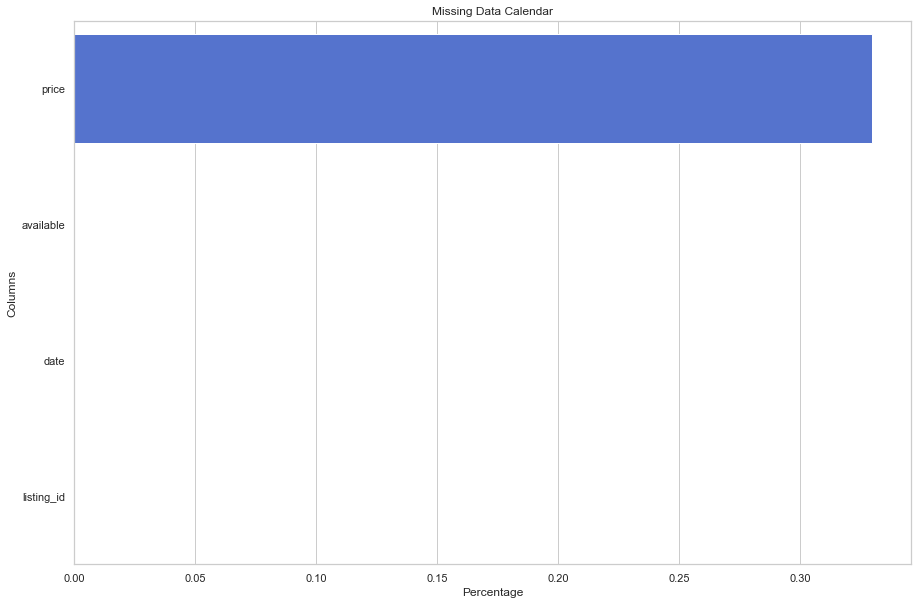

In [6]:
plot_df = calendar.isnull().mean().sort_values(ascending=False).reset_index( )
plot_df.columns = ['Columns', 'Percentage'] 
sns.barplot(data=plot_df, y='Columns', x='Percentage', color="royalblue").set_title('Missing Data Calendar'); 

* Created a function to clean calendar data, and add additional columns for the analysis.

In [2]:
def clean_calendar_data(df):
   """Cleans calendar data and creates supporting columns

    Args:
        df (obj): calendar data frame

    Returns:
        df (obj): clean data frame
    """
    if df not None:
        df['date'] = pd.to_datetime(df["date"])
        df['price'] = df['price'].str.replace(',', '').str.replace('$', '').astype('float')
        df['month_name'] = df['date'].dt.month_name()
        df['month_name'] = pd.Categorical(df['month_name'], 
            categories=['January', 'February', 'March', 'April','May', 'June', 
            'July', 'August', 'September', 'October', 'November' , 'December' ],
             ordered=True)
    else: print("Please provide calendar data")
    return df

calendar_clean_df = clean_calendar_data(calendar)
calendar_clean_df.head()


,listing_id,date,available,price,month_name
0,241032,2016-01-04,t,85.0,January
1,241032,2016-01-05,t,85.0,January
2,241032,2016-01-06,f,NaN,January
3,241032,2016-01-07,f,NaN,January
4,241032,2016-01-08,f,NaN,January


In [8]:
calendar_clean_df.describe()

,listing_id,date,available,price,month_name
0,241032,2016-01-04,t,85.0,January
1,241032,2016-01-05,t,85.0,January
2,241032,2016-01-06,f,NaN,January
3,241032,2016-01-07,f,NaN,January
4,241032,2016-01-08,f,NaN,January


## 1. Are there any changes in price listings from month to month in the Airbnb Seattle prices?

* Created a mask to select available calendar listings
* Grouped and created avg price, median price, and total record count
* Displayed summary by month 
* Plotted data

In [3]:
mask = calendar_clean_df.available == 't'

calendar_summary =calendar_clean_df[mask]

calendar_summary = calendar_summary.groupby('month_name').agg(
    avg_price=('price', 'mean'),
    median_price=('price', 'median'),
    total_count=('month_name', 'count')).reset_index()

In [12]:
calendar_summary

,month_name,avg_price,median_price,total_count
0,January,122.912176,99.0,64937
1,February,124.293927,100.0,73321
2,March,128.644488,100.0,83938
3,April,135.097005,110.0,76037
4,May,139.538183,110.0,79971
5,June,147.473137,110.0,77244
6,July,152.094150,115.0,74222
7,August,150.656594,114.0,76347
8,September,143.255949,110.0,77246
9,October,137.031939,109.0,82438


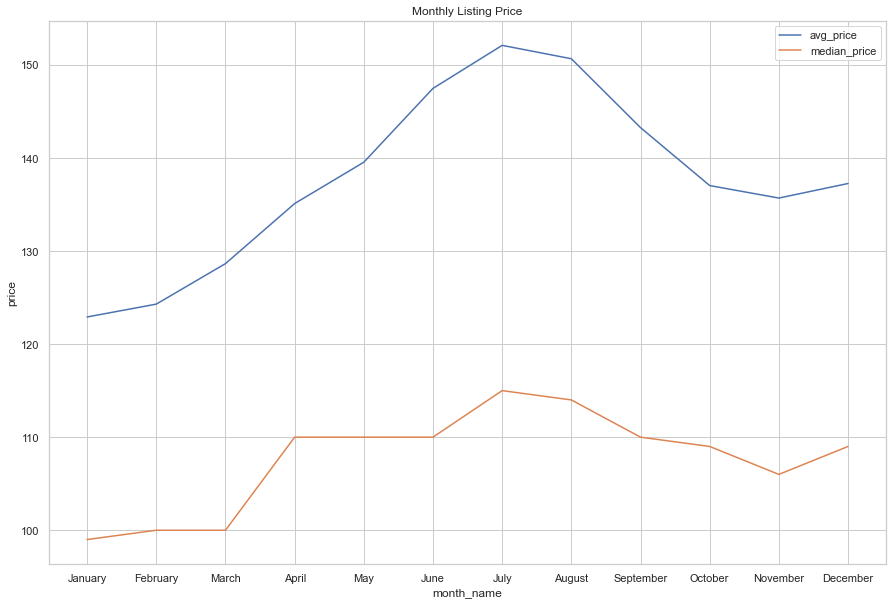

In [10]:
sns.lineplot(x='month_name', y='avg_price', label="avg_price", data=calendar_summary).set_title('Monthly Listing Price')
sns.lineplot(x='month_name', y='median_price', label="median_price", data=calendar_summary).set(ylabel='price');

# Listings DF

* Displayed top records in the listing data frame
* Showed listing information using pandas .info method

In [79]:
listings.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,...,10.0,f,NaN,WASHINGTON,f,moderate,f,f,2,4.07
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",...,10.0,f,NaN,WASHINGTON,f,strict,t,t,6,1.48
2,3308979,https://www.airbnb.com/rooms/3308979,20160104002432,2016-01-04,New Modern House-Amazing water view,New modern house built in 2013. Spectacular s...,"Our house is modern, light and fresh with a wa...",New modern house built in 2013. Spectacular s...,none,Upper Queen Anne is a charming neighborhood fu...,...,10.0,f,NaN,WASHINGTON,f,strict,f,f,2,1.15
3,7421966,https://www.airbnb.com/rooms/7421966,20160104002432,2016-01-04,Queen Anne Chateau,A charming apartment that sits atop Queen Anne...,NaN,A charming apartment that sits atop Queen Anne...,none,NaN,...,NaN,f,NaN,WASHINGTON,f,flexible,f,f,1,NaN
4,278830,https://www.airbnb.com/rooms/278830,20160104002432,2016-01-04,Charming craftsman 3 bdm house,Cozy family craftman house in beautiful neighb...,Cozy family craftman house in beautiful neighb...,Cozy family craftman house in beautiful neighb...,none,We are in the beautiful neighborhood of Queen ...,...,9.0,f,NaN,WASHINGTON,f,strict,f,f,1,0.89


In [80]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3818 entries, 0 to 3817
Data columns (total 92 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                3818 non-null   int64  
 1   listing_url                       3818 non-null   object 
 2   scrape_id                         3818 non-null   int64  
 3   last_scraped                      3818 non-null   object 
 4   name                              3818 non-null   object 
 5   summary                           3641 non-null   object 
 6   space                             3249 non-null   object 
 7   description                       3818 non-null   object 
 8   experiences_offered               3818 non-null   object 
 9   neighborhood_overview             2786 non-null   object 
 10  notes                             2212 non-null   object 
 11  transit                           2884 non-null   object 
 12  thumbn

* Extracted columns with missing values
* Plot of the percentage missing data by column

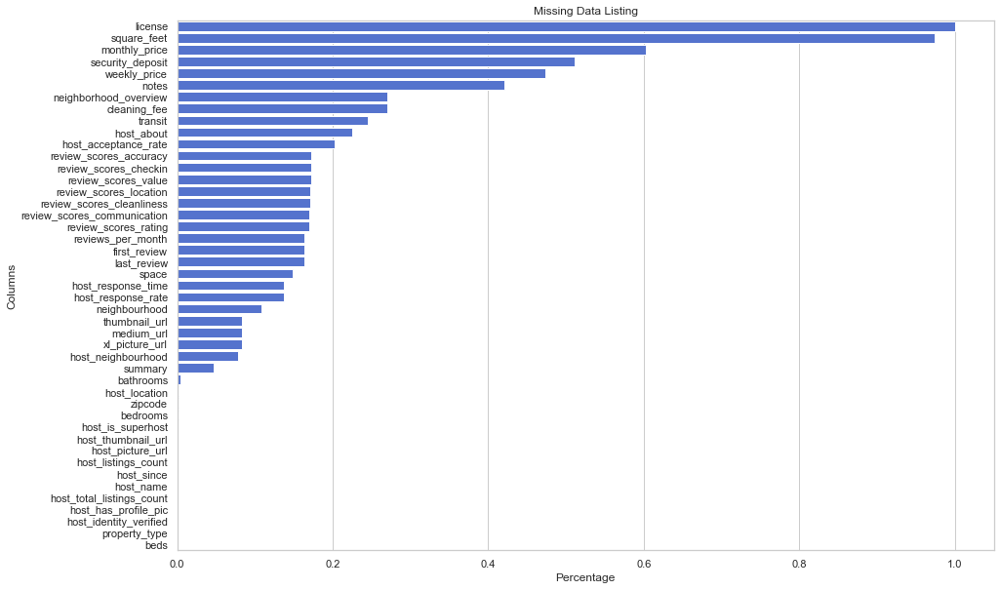

In [16]:
list_plot = listings.isnull().mean()
list_plot = list_plot[list_plot>0].sort_values(ascending=False).reset_index()
list_plot.columns = ['Columns', 'Percentage'] 
sns.barplot(data=list_plot, y='Columns', x='Percentage', color="royalblue").set_title('Missing Data Listing'); 

* Created mask to filter calendar data
* Applied mask to calendar data
* Selected exploratory variables of interest
* Merged calendar and listing by ID

In [3]:
mask = calendar.available == 't'

merged_df = calendar[mask].merge(listings[['id','neighbourhood_group_cleansed','property_type','room_type','accommodates']],
        how = 'left', left_on = 'listing_id', right_on = 'id')

print(merged_df.dtypes)

listing_id                              object
date                            datetime64[ns]
available                               object
price                                  float64
month_name                            category
id                                      object
neighbourhood_group_cleansed            object
property_type                           object
room_type                               object
accommodates                             int64
dtype: object


In [16]:
merged_df.describe()

,price,accommodates
count,934542.000000,934542.000000
mean,137.944859,3.317107
std,105.062870,1.997961
min,10.000000,1.000000
25%,75.000000,2.000000
50%,109.000000,2.000000
75%,160.000000,4.000000
max,1650.000000,16.000000


## 2. Are there price differences in the types of properties?

* Box plot of accommodates by price

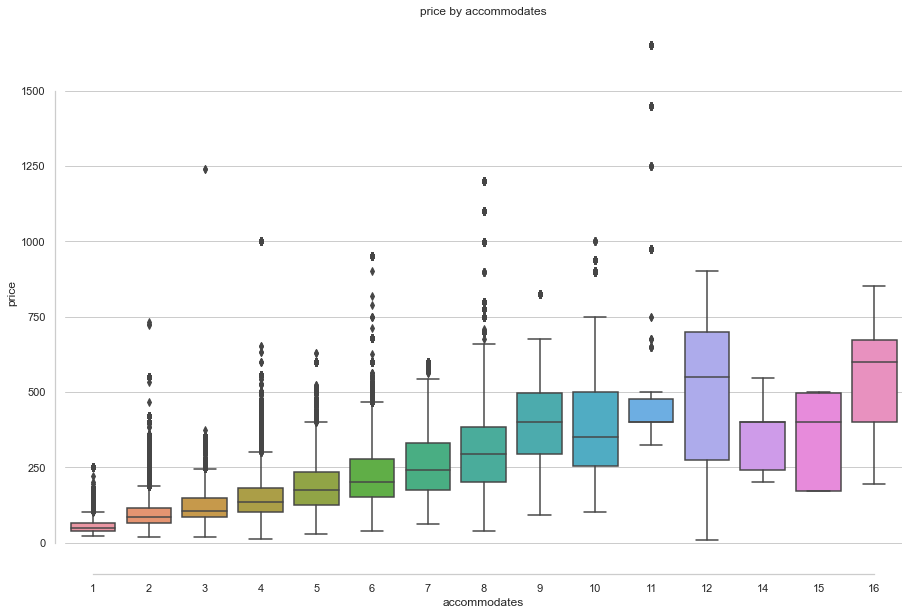

In [17]:
sns.boxplot(x="accommodates", y="price", data=merged_df).set_title('price by accommodates'); 
sns.despine(offset=10, trim=True)

* Box plot of property type by price

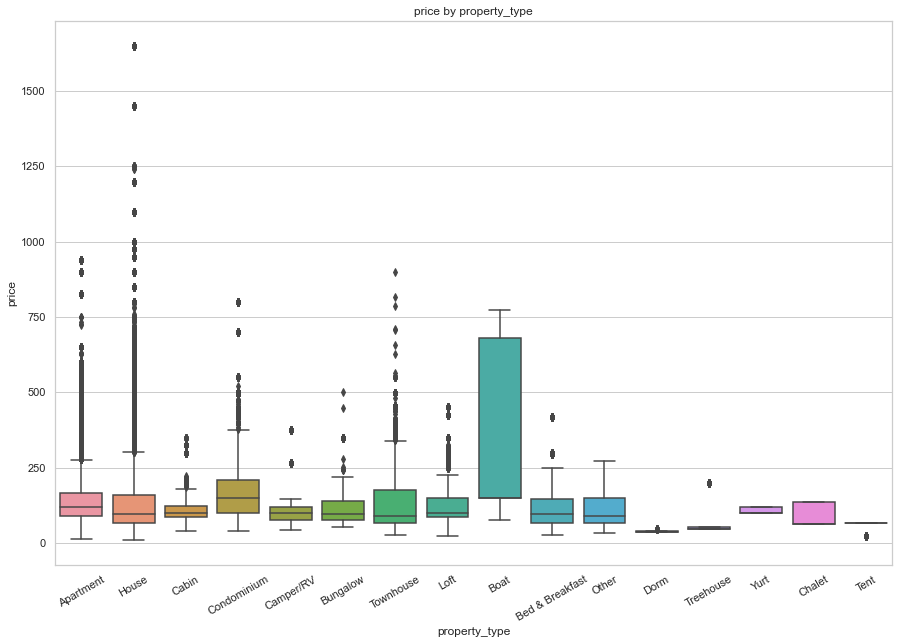

In [18]:
myplot = sns.boxplot(x="property_type", y="price", data=merged_df)
myplot.set_title('price by property_type')
myplot.set_xticklabels(myplot.get_xticklabels(), rotation=30);

* Box plot of room type by price

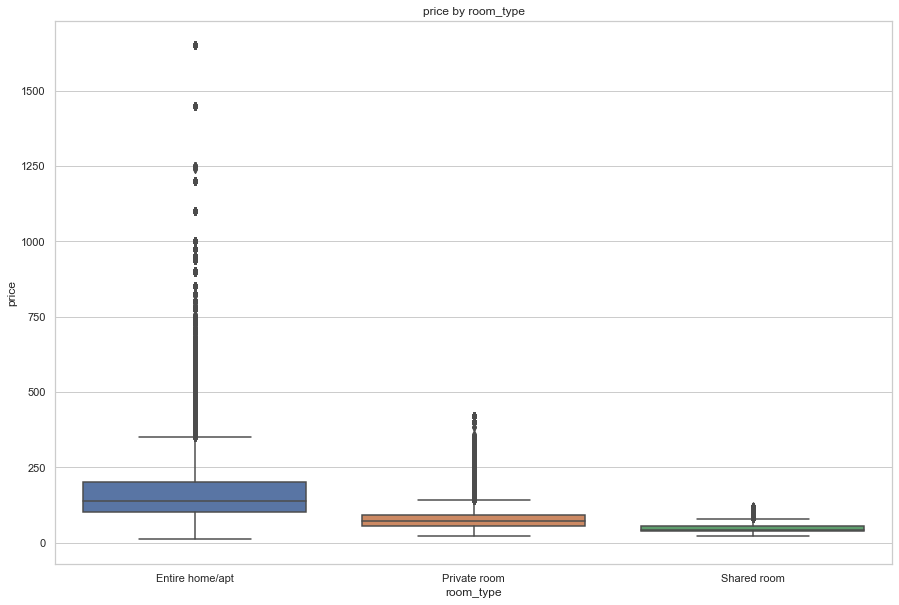

In [19]:
myplot = sns.boxplot(x="room_type", y="price",data=merged_df)
myplot.set_title('price by room_type');

* Grouped by neighbourhood and summarized by avg and count
* Used pandas describe method to summarized numberical columns

In [22]:
neighbour_summary = merged_df.groupby('neighbourhood_group_cleansed').agg(
    avg_price=('price', 'mean'),
    listing_count=('neighbourhood_group_cleansed', 'count')
    ).reset_index()

neighbour_summary.describe()

,avg_price,listing_count
count,17.000000,17.000000
mean,129.373173,54973.058824
std,33.654305,52581.021189
min,90.926944,3394.000000
25%,100.668781,18801.000000
50%,125.622015,33148.000000
75%,148.155804,66804.000000
max,198.694341,194661.000000


## 3. What neighbourhood accounts for the most listings?

* Printed summary
* Plotted neighbourhood by listing count in descending order

In [23]:
print(neighbour_summary)

neighbourhood_group_cleansed   avg_price  listing_count
0                       Ballard  125.905980          58115
1                   Beacon Hill  100.668781          30270
2                  Capitol Hill  134.671895         132668
3                       Cascade  154.033178          18717
4                  Central Area  134.883729          90556
5                      Delridge   90.926944          21545
6                      Downtown  187.343042         125725
7                      Interbay  118.421037           3394
8                     Lake City   94.518589          18801
9                      Magnolia  198.694341          17248
10                    Northgate   93.455532          21105
11          Other neighborhoods  125.622015         194661
12                   Queen Anne  176.117882          66804
13               Rainier Valley  100.104924          38914
14                  Seward Park  111.110338          10921
15          University District  104.709937          33148


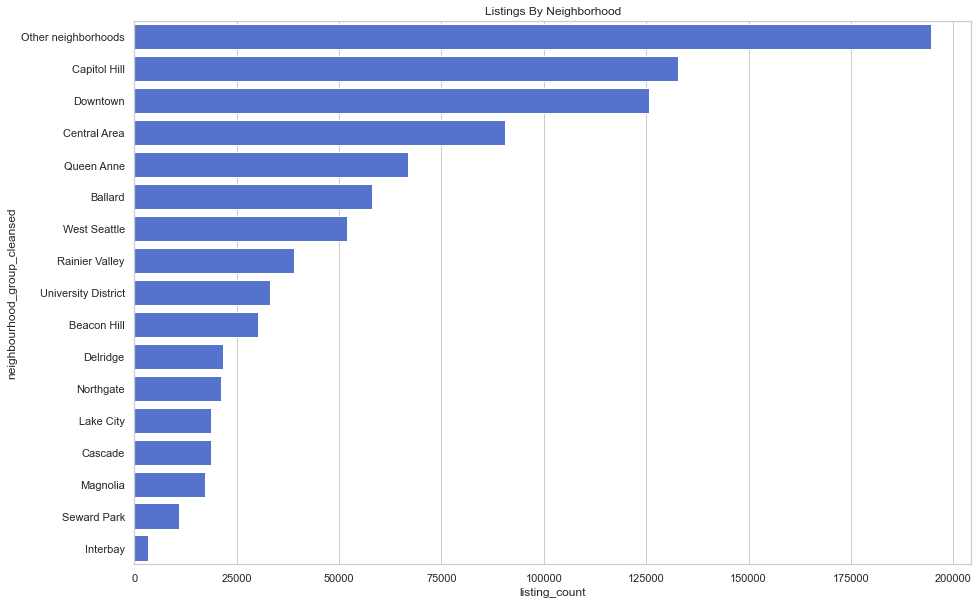

In [24]:
plot_df = neighbour_summary.sort_values(by='listing_count', ascending=False)
sns.barplot(data=plot_df, y='neighbourhood_group_cleansed', x='listing_count', color="royalblue").set_title('Listings By Neighborhood'); 

## 4. Does the price vary by neighborhood?

* Plot of avg price by neighborhood

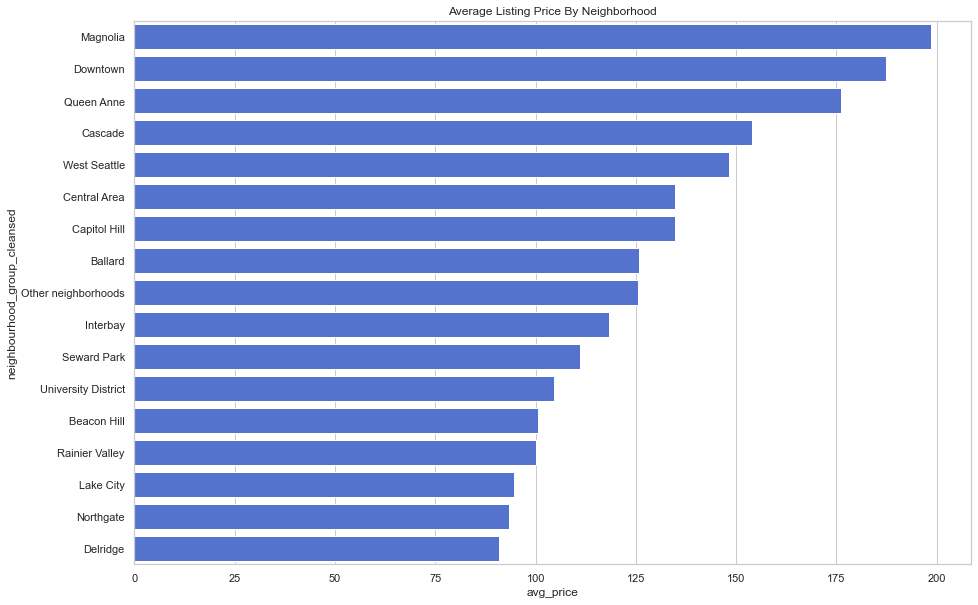

In [20]:
plot_df = neighbour_summary.sort_values(by='avg_price', ascending=False)
sns.barplot(data=plot_df, y='neighbourhood_group_cleansed', x='avg_price', color="royalblue").set_title('Average Listing Price By Neighborhood'); 

## 5. What features help predict listing price?

* Created cols variable to hold columns of interest for final question
* Filtered merged_df using the cols variable and assign to ml_df

In [4]:
cols = ['price', 'month_name', 'neighbourhood_group_cleansed', 'property_type', 'room_type', 'accommodates']
ml_df = pd.DataFrame(merged_df, columns=cols)
ml_df

,price,month_name,neighbourhood_group_cleansed,property_type,room_type,accommodates
0,85.0,January,Queen Anne,Apartment,Entire home/apt,4
1,85.0,January,Queen Anne,Apartment,Entire home/apt,4
2,85.0,January,Queen Anne,Apartment,Entire home/apt,4
3,85.0,January,Queen Anne,Apartment,Entire home/apt,4
4,85.0,January,Queen Anne,Apartment,Entire home/apt,4
...,...,...,...,...,...,...
934537,87.0,January,Queen Anne,Apartment,Entire home/apt,3
934538,87.0,January,Queen Anne,Apartment,Entire home/apt,3
934539,87.0,January,Queen Anne,Apartment,Entire home/apt,3
934540,87.0,January,Queen Anne,Apartment,Entire home/apt,3


Converted the `month_name`, `property_type`, `neighbourhood_group_cleansed`, `room_type`, and `accommodates` to dummy variables. The step will facilitate the understanding of each variable compared to the listing price. Additionally, the original variables will be a drop from the model, and the column names will be cleaned. A prefix will be added to each new column created. The `prop_other` and `neigh_other_neighborhoods` will be removed and become part of the base model.

In [5]:
df = pd.concat([ml_df,pd.get_dummies(ml_df['month_name'], prefix='m')],axis=1)
df = pd.concat([df,pd.get_dummies(df['property_type'], prefix='prop')],axis=1)
df = pd.concat([df,pd.get_dummies(df['neighbourhood_group_cleansed'], prefix='neigh')],axis=1)
df = pd.concat([df,pd.get_dummies(df['room_type'], prefix='room')],axis=1)
df = pd.concat([df,pd.get_dummies(df['accommodates'], prefix='acc')],axis=1)

df.drop(['month_name','property_type','neighbourhood_group_cleansed','room_type','accommodates'],axis=1, inplace=True)

df.columns = df.columns.str.lower().str.replace('/',' ').str.replace('\s+', ' ', regex=True).str.replace(' ','_')

del df['prop_other']
del df['neigh_other_neighborhoods']

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 934542 entries, 0 to 934541
Data columns (total 62 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   price                      934542 non-null  float64
 1   m_january                  934542 non-null  uint8  
 2   m_february                 934542 non-null  uint8  
 3   m_march                    934542 non-null  uint8  
 4   m_april                    934542 non-null  uint8  
 5   m_may                      934542 non-null  uint8  
 6   m_june                     934542 non-null  uint8  
 7   m_july                     934542 non-null  uint8  
 8   m_august                   934542 non-null  uint8  
 9   m_september                934542 non-null  uint8  
 10  m_october                  934542 non-null  uint8  
 11  m_november                 934542 non-null  uint8  
 12  m_december                 934542 non-null  uint8  
 13  prop_apartment             93

A random forest model will be used to variable significance against listing price. The data will be split 70/30 with a random state of 143, and run parallel with all cores minus one. After the model has been fitted, the RMSE and R^2 will be used to evaluate the model. The model will be used for exploratory purposes and is not optimized.

In [6]:

X = df.drop(columns=['price'])
y = df['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=143)

base_rfr = RandomForestRegressor(max_depth=15, random_state=143,n_jobs=-2)
base_rfr.fit(X_train, y_train)

predict_train = base_rfr.predict(X_train)
predict_test = base_rfr.predict(X_test)
print('RMSE Train:', np.sqrt(metrics.mean_squared_error(y_train, predict_train)))
print("R^2 Train:",r2_score(y_train, predict_train))
print('RMSE Test:', np.sqrt(metrics.mean_squared_error(y_test, predict_test)))
print("R^2 Test:",r2_score(y_test, predict_test))

RMSE Train: 60.00615869043711
R^2 Train: 0.6743760662348126
RMSE Test: 59.880186911727556
R^2 Test: 0.673796921298893


After the random forest model has been fitted, the top ten features by importance will be plotted.

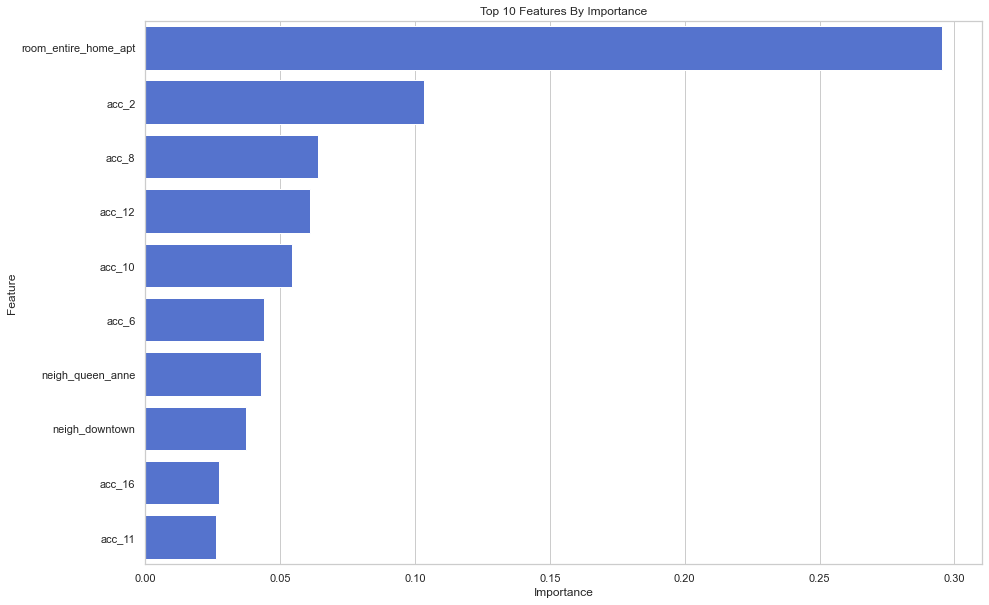

In [10]:
feat_imp = pd.Series(base_rfr.feature_importances_, index = X.columns)
top_plot = feat_imp.nlargest(10).reset_index()
top_plot.columns = ['Feature', 'Importance'] 
top_plot = top_plot.sort_values(by='Importance', ascending=False)
sns.barplot(data=top_plot, y='Feature', x='Importance', color="royalblue").set_title('Top 10 Features By Importance');